In [ ]:
# 1. raw data의 'SEQ'별 len을 구한다. 
# 2. 그 값을 SEQ, multiplier를 컬럼으로 갖는 df(multi_df)로 저장한다. (multiplier는 행의 수 x 3)
# 3. df를 'SEQ' 기준으로 대분류로 group by한다.
# 4. 두 df를 murge한다
# 5. 각 컬럼의 카드 내역 값에 multiplier 값을 곱한다.

In [1]:
import pandas as pd
df = pd.read_csv('edu_data_F.csv')

In [2]:
result = df.groupby('SEQ')[['INTERIOR_AM', 'INSUHOS_AM', 'OFFEDU_AM', 'TRVLEC_AM', 
                            'FSBZ_AM', 'SVCARC_AM', 'DIST_AM', 'PLSANIT_AM', 
                            'CLOTHGDS_AM', 'AUTO_AM']].sum().reset_index()

In [3]:
grouped = df.groupby('SEQ').apply(lambda x: len(x) * 3000)
grouped_df = grouped.reset_index()
grouped_df.columns = ['SEQ', 'multiplier']

In [4]:
merged_df = pd.merge(grouped_df, result, on='SEQ')
result_multiplied = merged_df[['SEQ']].join(merged_df.iloc[:, 2:].mul(merged_df['multiplier'], axis=0))

In [5]:
pd.set_option('display.float_format', lambda x: '%.0f' % x)

In [6]:
result_multiplied.to_csv('car_price_origin.csv')

In [7]:
mask = result_multiplied['AUTO_AM'] != 0
result_multiplied['CAR_PRICE'] = 0  # 일단 모든 값을 0으로 설정
result_multiplied.loc[mask, 'CAR_PRICE'] = (result_multiplied.loc[mask, 'INTERIOR_AM'] * 0.2 +
                                            result_multiplied.loc[mask, 'INSUHOS_AM'] * 0.2 +
                                            result_multiplied.loc[mask, 'OFFEDU_AM'] * 0.2 +
                                            result_multiplied.loc[mask, 'TRVLEC_AM'] * 0.2 +
                                            result_multiplied.loc[mask, 'FSBZ_AM'] * 0.2 +
                                            result_multiplied.loc[mask, 'SVCARC_AM'] * 0.2 +
                                            result_multiplied.loc[mask, 'DIST_AM'] * 0.2 +
                                            result_multiplied.loc[mask, 'PLSANIT_AM'] * 0.2 +
                                            result_multiplied.loc[mask, 'CLOTHGDS_AM'] * 0.2 +
                                            result_multiplied.loc[mask, 'AUTO_AM'] * 10)

result_multiplied

,SEQ,INTERIOR_AM,INSUHOS_AM,OFFEDU_AM,TRVLEC_AM,FSBZ_AM,SVCARC_AM,DIST_AM,PLSANIT_AM,CLOTHGDS_AM,AUTO_AM,CAR_PRICE
0,00011N2I1MX4X9NQ16C0,0,0,0,0,5880000,0,21840000,0,0,840000,13944000
1,0003UZ715F1AVTCFVTLJ,0,16560000,15120000,1200000,10560000,2160000,76320000,960000,240000,0,0
2,0005S4MIPCAD7O9L801P,0,0,0,0,90000,0,3150000,0,0,0,0
3,000C4EHXNK4O3VQRPMG3,0,60000,0,0,120000,0,60000,0,0,0,0
4,000FQ6EU9C0VJG9ECRUV,0,0,0,25920000,720000,13920000,480000,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
892992,ZZZJS8E5I9X9P42V1WQ6,2400000,10560000,0,10800000,60960000,5760000,29280000,0,2400000,18720000,211632000
892993,ZZZNH3R7DRMJPWLCQMMV,0,0,0,0,30000,0,0,0,0,0,0
892994,ZZZSRQZX590MEOQ9R4Z2,0,20880000,0,23520000,67200000,12480000,60480000,4560000,1440000,18960000,227712000
892995,ZZZTYB2T2QOJ3POXZGTN,0,0,0,0,0,0,0,0,0,5400000,54000000


In [8]:
result_multiplied

,SEQ,INTERIOR_AM,INSUHOS_AM,OFFEDU_AM,TRVLEC_AM,FSBZ_AM,SVCARC_AM,DIST_AM,PLSANIT_AM,CLOTHGDS_AM,AUTO_AM,CAR_PRICE
0,00011N2I1MX4X9NQ16C0,0,0,0,0,5880000,0,21840000,0,0,840000,13944000
1,0003UZ715F1AVTCFVTLJ,0,16560000,15120000,1200000,10560000,2160000,76320000,960000,240000,0,0
2,0005S4MIPCAD7O9L801P,0,0,0,0,90000,0,3150000,0,0,0,0
3,000C4EHXNK4O3VQRPMG3,0,60000,0,0,120000,0,60000,0,0,0,0
4,000FQ6EU9C0VJG9ECRUV,0,0,0,25920000,720000,13920000,480000,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
892992,ZZZJS8E5I9X9P42V1WQ6,2400000,10560000,0,10800000,60960000,5760000,29280000,0,2400000,18720000,211632000
892993,ZZZNH3R7DRMJPWLCQMMV,0,0,0,0,30000,0,0,0,0,0,0
892994,ZZZSRQZX590MEOQ9R4Z2,0,20880000,0,23520000,67200000,12480000,60480000,4560000,1440000,18960000,227712000
892995,ZZZTYB2T2QOJ3POXZGTN,0,0,0,0,0,0,0,0,0,5400000,54000000


In [9]:
car_df = result_multiplied[result_multiplied['CAR_PRICE']!=0]

In [10]:
import pandas as pd
from sklearn.cluster import KMeans

# 카드 데이터만 선택
card_data = car_df.drop(columns=['SEQ', 'CAR_PRICE'])

# 클러스터링을 위한 KMeans 모델 학습
kmeans = KMeans(n_clusters=10)  # 클러스터 개수는 적절히 조절 가능
kmeans.fit(card_data)

# 각 고객이 속한 클러스터 예측
cluster_labels = kmeans.predict(card_data)

# 각 클러스터별 차량 가격의 평균 계산
cluster_centers = kmeans.cluster_centers_
cluster_car_price = pd.DataFrame(cluster_centers, columns=car_df.columns[1:-1])  # SEQ 및 CAR_PRICE 열 제외
cluster_car_price['cluster'] = range(len(cluster_car_price))  # 클러스터 인덱스 추가

# 각 고객에 대한 추천 차량 예산 계산
recommendations = car_df.copy()
recommendations['cluster'] = cluster_labels
recommendations = pd.merge(recommendations, cluster_car_price, on='cluster')

# 결과 출력
print(recommendations[['SEQ', 'CAR_PRICE']])


c:\Users\CHK\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


                         SEQ  CAR_PRICE
0       00011N2I1MX4X9NQ16C0   13944000
1       001ZPND1UT83IB916DC4   36912000
2       003BWUUUY2TAYT19XIX1   43296000
3       004BUK4YGZAAP8CK2A3G   11448000
4       004JADXXVG6C8KHUBT17   61632000
...                      ...        ...
385729  ZZUGMZ4UTEG4GUOG8CEM  105936000
385730  ZZWUI5DSIM6ZIKWUJE30   71526000
385731  ZZX9H9V31NGM5DASDZ5E  240720000
385732  ZZZHCT6AWPRO8PVIY2ES  139248000
385733  ZZZJS8E5I9X9P42V1WQ6  211632000

[385734 rows x 2 columns]


In [11]:
# 고객의 카드 데이터를 입력합니다. 여기서는 임의의 카드 데이터를 사용하겠습니다.
new_card_data = pd.DataFrame({
    'INTERIOR_AM': [5000000],
    'INSUHOS_AM': [2000000],
    'OFFEDU_AM': [1000000],
    'TRVLEC_AM': [500000],
    'FSBZ_AM': [3000000],
    'SVCARC_AM': [1500000],
    'DIST_AM': [2000000],
    'PLSANIT_AM': [1000000],
    'CLOTHGDS_AM': [800000],
    'AUTO_AM': [5000000]
})

# 앞서 학습한 KMeans 모델을 사용하여 클러스터 예측
cluster_label = kmeans.predict(new_card_data)

# 해당 클러스터에 해당하는 평균 차량 가격을 추출합니다.
cluster_mean_price = cluster_car_price[cluster_car_price['cluster'] == cluster_label[0]]['AUTO_AM'].values[0]


# 결과 출력
print("추천 예산:", cluster_mean_price)


추천 예산: 2013880.7974592936


In [12]:
import pandas as pd
from sklearn.cluster import KMeans

# 카드 데이터만 선택
card_data = car_df.drop(columns=['SEQ', 'CAR_PRICE'])

# 클러스터링을 위한 KMeans 모델 학습
kmeans = KMeans(n_clusters=10)  # 클러스터 개수는 적절히 조절 가능
kmeans.fit(card_data)

# 각 고객이 속한 클러스터 예측
cluster_labels = kmeans.predict(card_data)

# 클러스터링 결과를 데이터프레임에 추가
car_df['cluster'] = cluster_labels

# 각 클러스터별 차량 가격의 분위수 계산
cluster_car_prices = car_df.groupby('cluster')['CAR_PRICE'].describe(percentiles=[0.25, 0.5, 0.75])

# 결과 출력
print(cluster_car_prices[['25%', '50%', '75%']])


c:\Users\CHK\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


              25%       50%       75%
cluster                              
0        19530000  35280000  73248000
1        43188000  74352000 132696000
2        68976000 125232000 219840000
3         3552000   8574000  22710000
4        43440000  96000000 177588000
5       365952000 515232000 576144000
6        30864000  55680000 106284000
7        84720000 159480000 266112000
8        27600000  57120000 118368000
9        14592000  29568000  65472000


C:\Users\CHK\AppData\Local\Temp\ipykernel_20272\1677442592.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  car_df['cluster'] = cluster_labels


In [17]:
# 새로운 고객의 카드 데이터 예시
new_card_data = pd.DataFrame({
    'INTERIOR_AM': [2000000],
    'INSUHOS_AM': [1000000],
    'OFFEDU_AM': [0],
    'TRVLEC_AM': [300000],
    'FSBZ_AM': [1500000],
    'SVCARC_AM': [0],
    'DIST_AM': [0],
    'PLSANIT_AM': [600000000],
    'CLOTHGDS_AM': [40000000],
    'AUTO_AM': [0]
})

# 새로운 고객의 카드 데이터에 'cluster' 열 추가
# new_card_data['cluster'] = 0  # 새로운 데이터에 대한 임의의 값 설정


In [18]:

# 새로운 데이터에 대한 예측
new_cluster_label = kmeans.predict(new_card_data)

# 예측 결과 출력
print("새로운 데이터가 속한 클러스터:", new_cluster_label[0])



새로운 데이터가 속한 클러스터: 9


In [19]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE


In [20]:
# 카드 데이터를 2차원으로 축소
tsne = TSNE(n_components=2, random_state=42)

In [21]:
card_data_2d = tsne.fit_transform(card_data)

In [ ]:
# 클러스터 예측 결과를 시각화
plt.figure(figsize=(8, 6))
plt.scatter(card_data_2d[:, 0], card_data_2d[:, 1], c=cluster_labels, cmap='viridis', alpha=0.5)
plt.colorbar(label='Cluster')
plt.title('Cluster Visualization')
plt.xlabel('TSNE Component 1')
plt.ylabel('TSNE Component 2')
plt.show()


# 전체 데이터로 kmeans

In [11]:
import pandas as pd
from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor
from sklearn.metrics import mean_squared_error

X = result_multiplied.drop(['SEQ', 'CAR_PRICE'], axis=1)
y = result_multiplied['CAR_PRICE']

# 학습 데이터와 테스트 데이터로 분할
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# XGBoost 모델 학습
model = XGBRegressor()
model.fit(X_train, y_train)

# 테스트 데이터 예측 및 평가
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print("평균 제곱 오차:", mse)

평균 제곱 오차: 645614008472.5621


In [17]:
# 전체 데이터셋에 대해 예측값 출력
predicted_prices = model.predict(X)

# 실제값과 예측값 출력
for i in range(len(X)):
    print(f"실제값: {y[i]}, 예측값: {predicted_prices[i]}")


실제값: 13944000, 예측값: 13410656.0
실제값: 0, 예측값: 52834.0625
실제값: 0, 예측값: -3694.14013671875
실제값: 0, 예측값: -2726.67333984375
실제값: 0, 예측값: 34988.12890625
실제값: 0, 예측값: 3565.7734375
실제값: 0, 예측값: 20154.43359375
실제값: 9690000, 예측값: 8713756.0
실제값: 0, 예측값: 113290.25
실제값: 0, 예측값: -17049.451171875
실제값: 0, 예측값: -4543.9521484375
실제값: 39504000, 예측값: 40112296.0
실제값: 76272000, 예측값: 73481056.0
실제값: 0, 예측값: -42849.234375
실제값: 0, 예측값: -6459.6494140625
실제값: 1746000, 예측값: 1553259.875
실제값: 71280000, 예측값: 71108976.0
실제값: 0, 예측값: -5065.57421875
실제값: 4152000, 예측값: 4154359.0
실제값: 0, 예측값: 26226.736328125
실제값: 223200000, 예측값: 224123664.0
실제값: 0, 예측값: -17544.876953125
실제값: 102624000, 예측값: 101913664.0
실제값: 0, 예측값: 8553.6923828125
실제값: 15816000, 예측값: 14898443.0
실제값: 0, 예측값: -2726.67333984375
실제값: 0, 예측값: 5150.22998046875
실제값: 0, 예측값: 76174.0234375
실제값: 604368000, 예측값: 603793728.0
실제값: 0, 예측값: -7617.04736328125
실제값: 0, 예측값: 88063.7578125
실제값: 0, 예측값: 69755.4765625
실제값: 36912000, 예측값: 36112888.0
실제값: 0, 예측값: 63606.921875
실제값

In [ ]:
X = car_df.drop(['SEQ', 'CAR_PRICE'], axis=1)
y = car_df['CAR_PRICE']

# 학습 데이터와 테스트 데이터로 분할
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# XGBoost 모델 학습
model = XGBRegressor()
model.fit(X_train, y_train)

# 테스트 데이터 예측 및 평가
y_pred = model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print("평균 제곱 오차:", mse)

In [24]:
import pandas as pd
from sklearn.cluster import KMeans

# 카드 데이터만 선택
card_data = result_multiplied.drop(columns=['SEQ', 'CAR_PRICE'])

# 클러스터링을 위한 KMeans 모델 학습
kmeans = KMeans(n_clusters=10)  # 클러스터 개수는 적절히 조절 가능
kmeans.fit(card_data)

# 각 고객이 속한 클러스터 예측
cluster_labels = kmeans.predict(card_data)

# 각 클러스터별 차량 가격의 평균 계산
cluster_centers = kmeans.cluster_centers_
cluster_car_price = pd.DataFrame(cluster_centers, columns=result_multiplied.columns[1:-1])  # SEQ 및 CAR_PRICE 열 제외
cluster_car_price['cluster'] = range(len(cluster_car_price))  # 클러스터 인덱스 추가

# 각 고객에 대한 추천 차량 예산 계산
recommendations = result_multiplied.copy()
recommendations['cluster'] = cluster_labels
recommendations = pd.merge(recommendations, cluster_car_price, on='cluster')

# 결과 출력
print(recommendations[['SEQ', 'CAR_PRICE']])


c:\Users\CHK\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


                         SEQ  CAR_PRICE
0       00011N2I1MX4X9NQ16C0   13944000
1       000R78WEO9AWFSRYWWP4    9690000
2       000ULDEUEPPED2TMGTYB          0
3       0017326T5F15284KF0OZ          0
4       001GGMZSJD463DX0V6YS          0
...                      ...        ...
892992  ZZQ78Y2KN0HTBO0DICB9   75120000
892993  ZZQFPCB8QSJ63YD7R64Y   46176000
892994  ZZQZMF9DAKIP2L7KL07D          0
892995  ZZWLV8NCW3J1ZH0CNOA2   19824000
892996  ZZZVZY1T3AETPLR5ENVN          0

[892997 rows x 2 columns]


In [25]:
# 고객의 카드 데이터를 입력합니다. 여기서는 임의의 카드 데이터를 사용하겠습니다.
new_card_data = pd.DataFrame({
    'INTERIOR_AM': [5000000],
    'INSUHOS_AM': [2000000],
    'OFFEDU_AM': [1000000],
    'TRVLEC_AM': [500000],
    'FSBZ_AM': [3000000],
    'SVCARC_AM': [1500000],
    'DIST_AM': [2000000],
    'PLSANIT_AM': [1000000],
    'CLOTHGDS_AM': [800000],
    'AUTO_AM': [5000000]
})

# 앞서 학습한 KMeans 모델을 사용하여 클러스터 예측
cluster_label = kmeans.predict(new_card_data)

# 해당 클러스터에 해당하는 평균 차량 가격을 추출합니다.
cluster_mean_price = cluster_car_price[cluster_car_price['cluster'] == cluster_label[0]]['AUTO_AM'].values[0]


# 결과 출력
print("추천 예산:", cluster_mean_price)


추천 예산: 483004.030048172


In [28]:
import pandas as pd
from sklearn.cluster import KMeans

# 카드 데이터만 선택
card_data = result_multiplied.drop(columns=['SEQ', 'CAR_PRICE'])

# 클러스터링을 위한 KMeans 모델 학습
kmeans = KMeans(n_clusters=10)  # 클러스터 개수는 적절히 조절 가능
kmeans.fit(card_data)

# 각 고객이 속한 클러스터 예측
cluster_labels = kmeans.predict(card_data)

# 클러스터링 결과를 데이터프레임에 추가
result_multiplied['cluster'] = cluster_labels

# 각 클러스터별 차량 가격의 분위수 계산
cluster_car_prices = result_multiplied.groupby('cluster')['CAR_PRICE'].describe(percentiles=[0.25, 0.5, 0.75])

# 결과 출력
print(cluster_car_prices[['25%', '50%', '75%']])


c:\Users\CHK\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


              25%       50%       75%
cluster                              
0               0   4752000  25560000
1               0  38784000  90768000
2               0         0    432000
3               0  25488000  64536000
4        37392000  83664000 177144000
5               0  10128000  33552000
6               0  19368000  63228000
7        48816000 123984000 227028000
8       348096000 496800000 576048000
9        14928000  52560000 129504000


In [30]:
# 새로운 고객의 카드 데이터 예시
new_card_data = pd.DataFrame({
    'INTERIOR_AM': [2000000],
    'INSUHOS_AM': [1000000],
    'OFFEDU_AM': [500000],
    'TRVLEC_AM': [300000],
    'FSBZ_AM': [1500000],
    'SVCARC_AM': [800000],
    'DIST_AM': [1000000],
    'PLSANIT_AM': [600000],
    'CLOTHGDS_AM': [400000],
    'AUTO_AM': [2000000]
})
# 새로운 고객의 카드 데이터에 'cluster' 열 추가
new_card_data['cluster'] = 0

# 새로운 고객 데이터를 기반으로 클러스터 예측
new_cluster_label = kmeans.predict(new_card_data)

# 예측된 클러스터 출력
print("새로운 고객의 클러스터:", new_cluster_label[0])



새로운 고객의 클러스터: 2


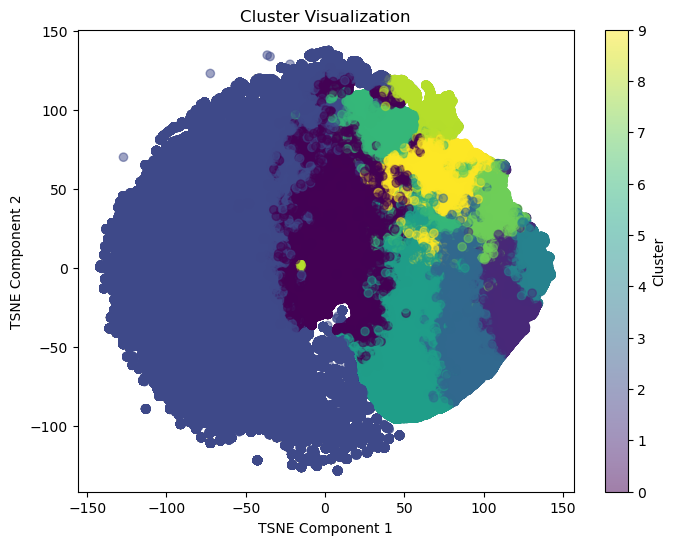

In [31]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE

# 카드 데이터를 2차원으로 축소
tsne = TSNE(n_components=2, random_state=42)
card_data_2d = tsne.fit_transform(card_data)

# 클러스터 예측 결과를 시각화
plt.figure(figsize=(8, 6))
plt.scatter(card_data_2d[:, 0], card_data_2d[:, 1], c=cluster_labels, cmap='viridis', alpha=0.5)
plt.colorbar(label='Cluster')
plt.title('Cluster Visualization')
plt.xlabel('TSNE Component 1')
plt.ylabel('TSNE Component 2')
plt.show()
